# IV Neuroniniai tinklai

## Temos

<code>**1  : Daugiasluoksnio neuroninio tinklo architektūra**</code><br>
<code>**2  : Skirtingi mokymosi algoritmai**</code><br>
<code>**3  : Netiesinės aktivacijos funkcijos: sigmoidas, tanh, ReLU ir kt.**</code><br>
<code>**4  : Plotis vs Gylis architektūros**</code><br>
<code>**5  : Daugiasluoksnio perceptrono programavimas**</code><br>
<code>**7  : Neuroninių tinklų apmokymas**</code><br>
<code>**7  : Perteklinis ir nepakankamas pritaikymas**</code><br>
<code>**8  : Skaičių ir alfabeto simbolių klasifikatorius**</code><br>
<code>**9  : Pytorch duomenų krautuvai**</code><br>

# Daugiasliuoksnio neuroninio tinklo architektūra

Sukursime neuroninį tinklą kuris gebės išspresti XOR problemą ir dar kadangi visgi gyvenime nedažnai sutinkame XOR problemas panaudosime šią techniką klasifikuoti skaičius ir alfabeto simbolius ir pan.
Diaugiasluoksnis perceptronas yra pilnai sujungtas kelių sluolksnių ar vieno sluoksnio neuroninis tinklas (ang. fully connected feedforward neural network with one or more hidden layers). 
Pilnais sujungtas reikšmė reiškia kad visi mazgai iš vieno sluoksnio yra susijungę su kito sluoksniuos visais mazgais. Apmokyti DNN naudosime alogirtmą kuris vaidinams <code>**dauginimas atgal (ang. backpropagation)**</code> kas iš emsė yra gradientinio nusileidimo algorimtas naudojant gradines taisykle. Tai pat DNN būdingas <code>**dauginimas pirmyn (ang. feedforward)**</code> kuris yra vienkryptis iš įvesties į išvestį. Vėliau susipažinsime su NN kurie neturi šios savybes tokie kaip pakartotniniai neuroninia tinklai (ang. recurrent networks), jie turės pakartotini sluoksnį kurie grįžtą atgal iš esmės yra laiko dimensija. Tačiau ne visi neuroniniai tinklai yra pilnai sujungti, mes vėliau susipažinsime su tokio tipo NN, jie vadinami konvoliuciniai neuroniniai tinklai. 

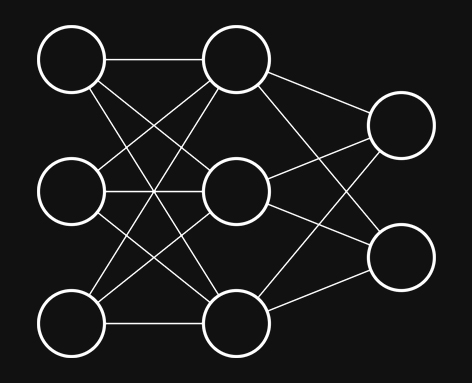

Žemiau esančiame NN struktūroje mes turime viena įvesties, du paslėptus sluoksnius, ir vieną išvesties sluoksnį. Kadangi turime tik vieną išvestį tai toks NN spręs binarę klasifikacijos problemą panašiai kaip darė logistinė regresiją tačiau skirtingai nei (neaptarta) softmax regresija todėl išvesčiai tai pat naudosime sigmoidinę funkciją kaip aktyvacijos funkciją. Daugiau be to kad tai tiesiog komplikuotesnė struktūra (paslėpti sluoksniai) niekuo nesiskiria nuo logisitnės regresijos. <br>
<b>(iliustracijoje neparodyti poslinkio vienetai)</b>

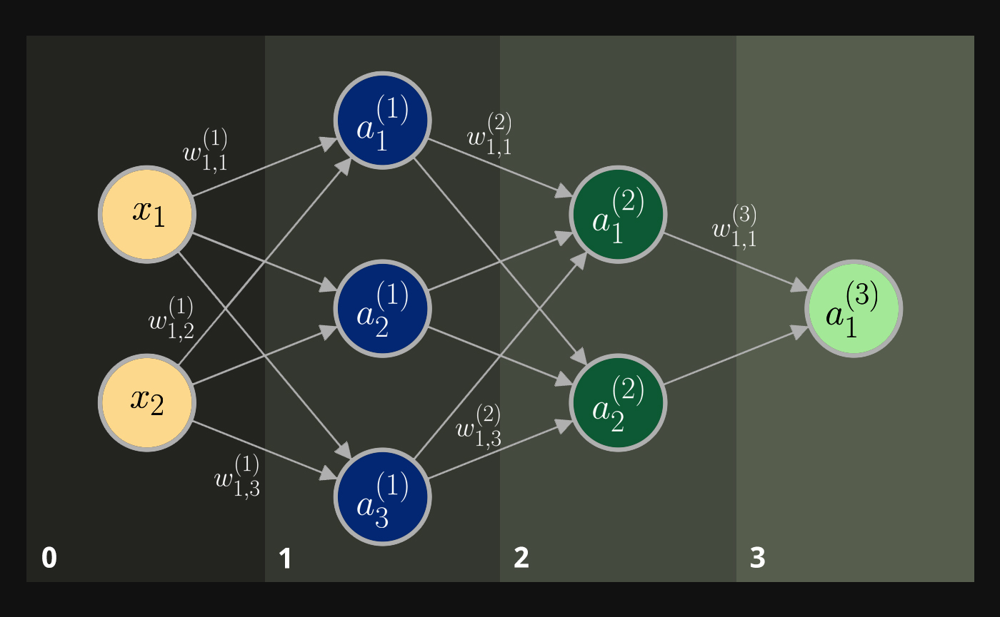

Kai apskaičiuojame dalines išvestines šio tinklo mokymui, galime naudoti `kelių kintamųjų grandinės taisyklę`. Jei norėtume apskaičiuoti išvestinę šios kainos funkcijos dalinę išvestį, atsižvelgiant į vieną iš svorių, naudotume `grandinės taisyklę eidami atgal`, o tada kelių kintamųjų grandinės taisyklę sujungtume skirtingų vienetų išvestį.<br>
<b>pvz:</b>

\begin{multline*}
\dfrac{\partial l}{\partial w^{(1)}_{1,1}} = \dfrac{\partial l}{\partial o} \cdot \dfrac{\partial o}{\partial a^{(2)}_1}
\cdot \dfrac{\partial a^{(2)}_{1}}{\partial a^{(1)}_{1}} \cdot \dfrac{\partial a^{(1)}_{1}}{\partial w^{(1)}_{1,1}} \ \ +
\dfrac{\partial l}{\partial o} \cdot \dfrac{\partial o}{\partial a^{(2)}_2} \cdot \dfrac{\partial a^{(2)}_2}{\partial a^{(1)}_1} \cdot \dfrac{\partial a^{(1)}_1}{\partial w^{(1)}_{1,1}}
\end{multline*}

Yra du keliai su kuriais atnaujintume savo svorį w(1,1). Atkreipkite dėmesį, kad yra keli svoriai, keli svorio sluoksniai ir jie taip pat tokiu budu būtų atnaujinami, tačiau taisyklė būtų šiek tiek kitokia. <code>**Pabandykite aprašyti vieną kelią patys.**</code><br>
\begin{multline*}
\dfrac{\partial l}{\partial w^{(2)}_{1,1}}
\end{multline*}

\begin{multline*}
\dfrac{\partial l}{\partial w^{(2)}_{1,1}} = \dfrac{\partial l}{\partial o} \ \cdot \ \dfrac{\partial o}{\partial a^{(2)}_{1}}
\ \cdot \ \dfrac{\partial a^{(2)_{1}}}{\partial w^{(2)}_{1,1}}
\end{multline*}

Atkreipkite dėmesį, kad tam tikra skaičiavimo dalis yra bendrinama ir mes galime pakartotinai panaudoti kai kurias dalis, toliau daugindami atgal. Ir įgyvendinant šiuos skaičiavimus praktiškai yra keletas gudrybių, kaip išvengti pakartotinio gradientų perskaičiavimo. Bet iš principo nieko naujo, lygiai tas pats ką taikėme (neaptarta) softmax regresijoje.

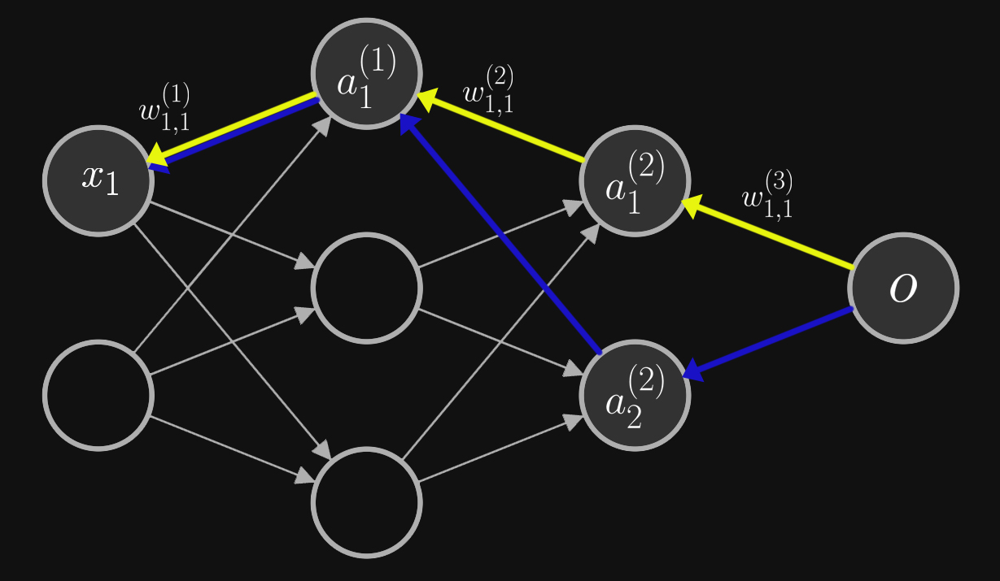

## Skirtingi mokymosi algoritmai

Algorimtas kuri mes naudojame apmokyti MLP (optimizuoti svorius) grįstas dalinių išvestinių arba gradientais tai vadinama (ang. backpropagation), skaičiavimas atgal. Ir tai po šiai dienai yra vienas efektyviausias ir tiksliausias algoritmu.

In [2]:
# TODO draw learning algorithms taxonomy figure

Tai kaip softmax regresijoje jeigu turime keletą išvesčių, vietoje sigmoid funkcijos galime naudoti softmax funkcija, jeigu tai yra kelių klasių problema su viena kitą paneigiančiomis klasėmis (mutually exclusive classes).

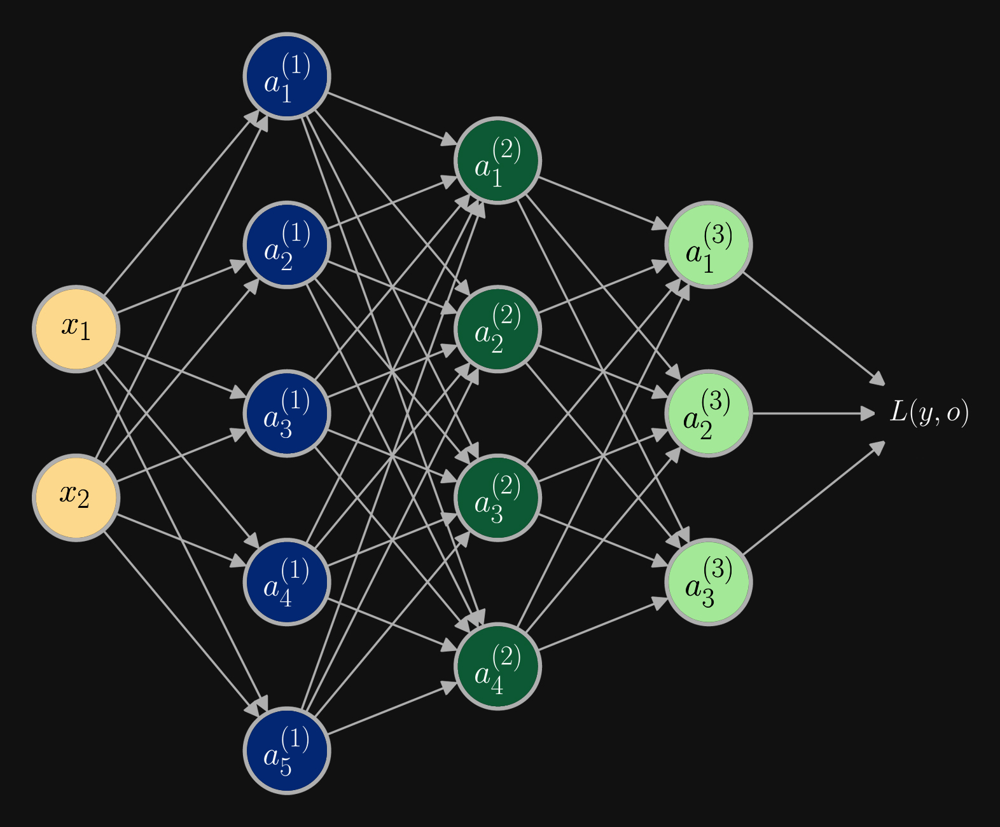

Kai buvo paminėtas gylusis neuroninis tinklas/mokymasis tai buvo refencija į savybių išmokymą naudojant specialius triukus kurie yra už tipinių daugiasluoksnių perceptrono galimybių tai buvo algoritminiai neuroninių tinklų patobulinimai kurie padaro pati mokymasis efektyvesniu.

Isidėmekite kad kainos/klaidos funkcija skirtingai nuo tiesinės, logistinės, softmax regresijos yra neišgaubta (non-convex). Praktikoje kiekviena kartą atliekant NN treniravimą mūsų gradientinio nusileidimo algoritmas sustovs skirtingose lokaliuose minimumose (atliekant pakartotine svorių inicializaciją ir duomenų rinkinio sumaišyma.) Tai pat praktikoje mes norime visada pakarototinai turėti vis skirtingas svorių reikšmes dėl to kad kartais tai ves prie geresnių rezultatų

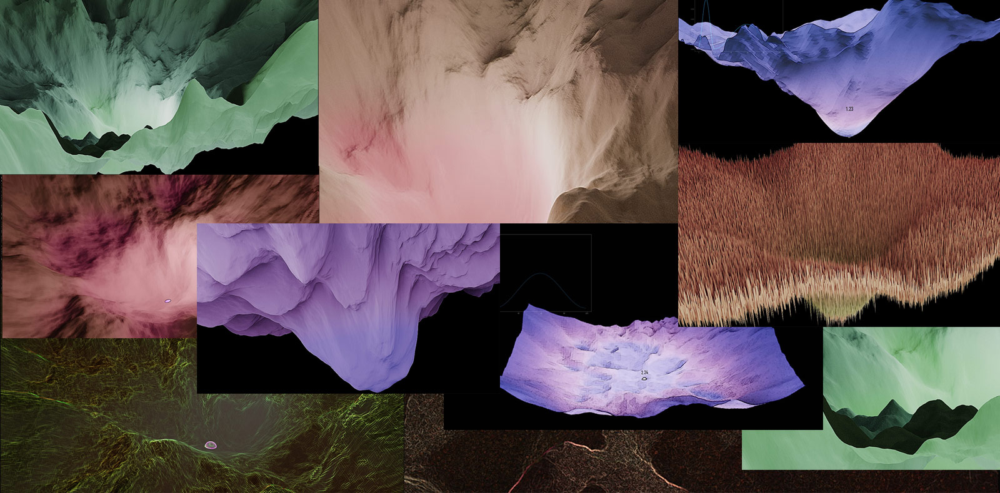

Daugiasluoksnių perceptronų atveju tai nebebus taip paprasta kaip buvo su tiesine,logistine regresija. Neturime tokių gražių išgaubtų (ang. convex) funkcijų, kur būtų pakankamai aiškus kelias žemyn iki globalaus minumumo. Taigi iš tikrųjų tai yra labai neišgaubti kainos funkcijos paviršiai. Taigi įsivaizduokite, kad neuroniniame tinkle turite dvejų sluoksnių kelis svorius, todėl funkcija gali būti labai sudėtinga. Yra daug vietinių minimumų ir kažkur vienas globalus. Ir priklausomai nuo to, kokie yra mūsų pradinės svorių reikšmės, pradėdami nuo atsitiktinių mažų verčių, ir kiekvieną kartą pradedame nuo kitokios pozicijos funkcijos srityje. Praktiškai sunku rasti visuotinį minimumą. Niekada nežinojome, ar pasiekėme globalų minimumą. Paprastai visiems žinoma, kad tiesio pasieksime kai kuriuos vietinius minimumus. Dėl to neuroninis tinklas treniruojamas kelis kartus su skirtingais atsitiktiniais svoriais. Kažkada pasieksime geresnių rezultatų tiesiog pakeitę atsitiktinę seką. Pastebėsite kad publikacijose apie NN taip pat neretai neuroninia tinklai treniruojami, tarkime penkis ar daugiau kartų, o po to iš trijų geriausių ciklų apskaičiuoti jų vidurkį ir registruoti standartinį nuokrypį. Taigi turėsi reikalų su labai neišgaubtu (ang. non covex) kainos funkcijos paviršiumi. Yra keletas gudrybių, kurias taikysime, pavyzdžiui, pasirinksime skirtingus mokymosi žingsius/greičius, skirtingus pradinius svorius ir optimizavimo algoritmus (ne SGD), kurie  kai kada padeda "iššokti" iš vietinių minimumumų, aišku jeigu ten įstringame.<br>
Dar tai pat labai be mokymosi žignsio ir optimizacijos algoritmo svarbu pasirinkti geras aktyvacijos funkcijas ir jų kombinacijas su kainos funkcijomis, pavyzdžiui:<br>
`Sigmoid aktivacija + MSE` (vidutinė kvadrato paklaida) turi labai plokščių gradientų problemą, kai išvestis yra labai neteisinga 10^-5 tikimybė ir  klasės etiketė 1. Jeigu atidžiau apie tai pagalvojus kad situacijoje kuomet yra labai bloga prognozė mes norime didelio gradiento kad galėtume atnaujinti svorius su didesnę reikšme.

<code>**MSE ir sigmoid funkcijos išvestinė**</code>

\begin{multline*}
\dfrac{\partial \mathcal{L}}{\partial w_{j}} = \dfrac{\partial \mathcal{L}}{\partial \sigma}  \ \cdot \ \dfrac{\partial \sigma}{\partial z}
\ \cdot \dfrac{\partial z}{\partial w}
\end{multline*}

\begin{multline*}
\dfrac{\partial \mathcal{L}}{\partial w_{j}} = - \dfrac{2}{n}(y - a) \odot \sigma(z) \odot (1 - \sigma(z)) \ x^{\top}_{j}
\end{multline*}

Žinoma daugiasluosnyje neuroniniame tinkle ir ne tik `softmax` (verčia tinklą išmokti tikimybių pasiskirstymą etiketėse) išvesties sluoksnyje yra geresnis nei sigmoidinis dėl vienas kitą paneigiančių etikečių, (neaptarta softmax), todėl išvesties sluoksnyje softmax paprastai yra geresnis už sigmoidinę aktivacijos funkciją.

In [4]:
import warnings
warnings.filterwarnings('ignore')

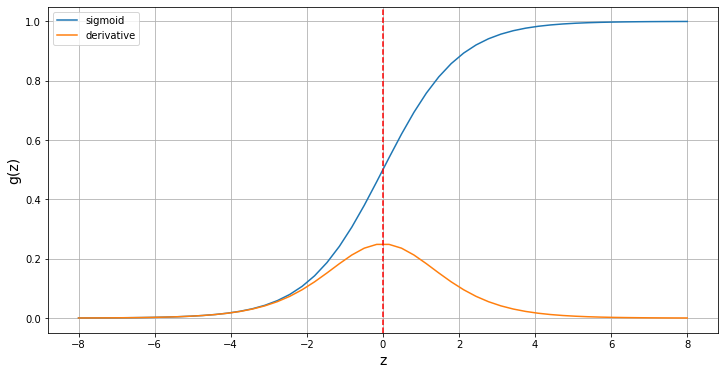

In [9]:
%run ../scripts/visualize/sigmoid_function.py

<div class="alert alert-block alert-success">
<h3>Pratybos:</h3>
Kas atsitiks jeigu mes MLP svorius inizializuosime taip kad jie visi bus 0 ?
</div>

## Netiesinės aktyvacijos funkcijos

Kartu su paslėptiais sluoksniais netiesinės aktivacijos funkcijos leidžia sukurti kompleksines netiesinius modelis, sprendimo ribas ir su tuo mes galime spręsti komplikuotas problemas. Pažiurėkite atidžiau į tas netiesines aktivacijos funkcijas MLP tinkle atidžiau 

In [ ]:
import torch
import torch.nn.functional as F

class MultliLayerPerceptron(torch.nn.Module):
    def __init__(self, s0, s1, s2, s3):
        super(MultliLayerPerceptron, self).__init__()
        
        #  sluoknsiai
        self.s1 = torch.nn.Linear(s0, s1)
        self.s2 = torch.nn.Linear(s1, s2)
        self.s3 = torch.nn.Linear(s2, s3)
        
        # perdavimas pirmyn
        def forward(self, x)
            out = self.s1(x)
            out = F.sigmoid(out)
            out = self.s2(out)
            out = F.sigmoid(out)
            
            logits = self.s3(out)
            probas = F.softmax(logits, dim=1)
            return logits, probas


In [ ]:
import torch
import torch.nn.functional as F

class MultliLayerPerceptron(torch.nn.Module):
    def __init__(self, s1, s2, s3, s4):
        super(MultliLayerPerceptron, self).__init__()
        
        #  sluoknsiai
        self.network = torch.nn.Sequential(
            torch.nn.Linear(s1, s2),
            torch.nn.ReLu(),
            torch.nn.Linear(s2, s3),
            torch.nn.ReLu(),
            torch.nn.Linear(s3, s ),
        )
        
        # perdavimas pirmyn
        def forward(self, x)
            logits = self.network(x)
            probas = F.softmax(logits, dim=1)
            return logits, probas


Sprendžiant XOR problema su netiesinėmis aktivacijomis kurios kaip jau minėjau leidžia sukurti kompleksinius modelis/sprendimo ribas. Čia mūsų `xor_data_II.csv` su dviem savybėmis `x1, x2` ir dviem klasėmis `0, 1`.

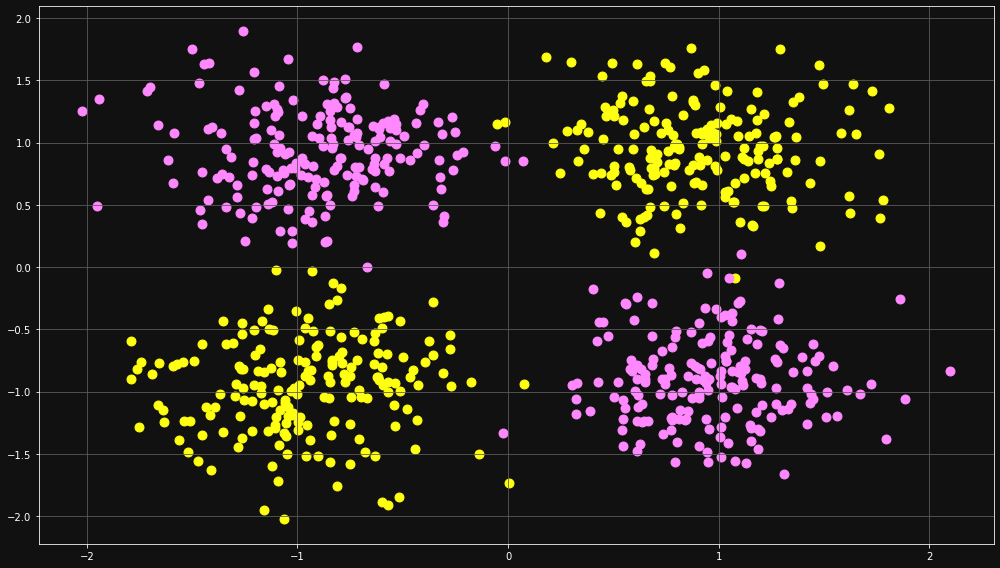

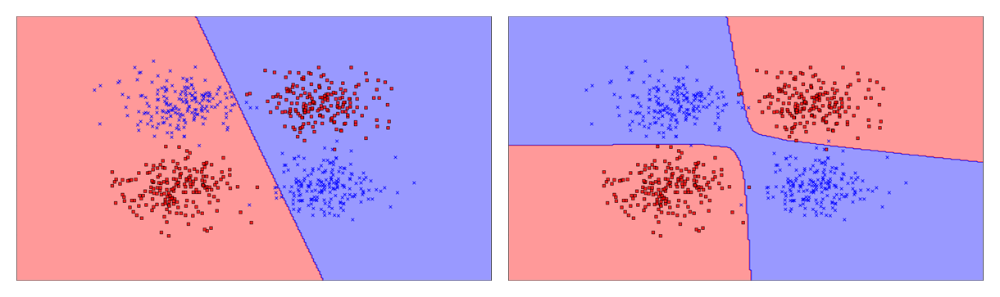

Turime NN kuomet taikėme tiesinę aktivacijos funkciją.
\begin{multline*}
\sigma(z) = z 
\end{multline*}

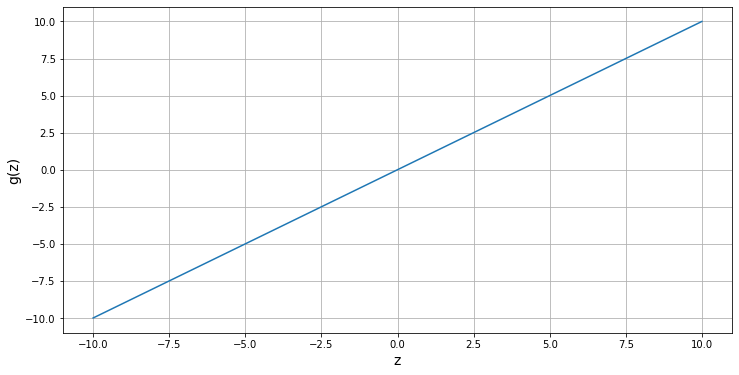

In [4]:
%run ../scripts/visualize/identity.py



Ir akivaizdu kad tai tiesinis modelis/sprendimo riba, net jeigu ir turime paslėptą sluoksnį. Tai kas čia atsitiko ? Logistinėje regresijoje naudojant ne tiesinę aktivacijos funkciją ir jokių papildomų sluoknsių gauname turėsime tiesinį modelį/sprendimo ribą. Dabar turime papildomą paslėptą sluoksnį ir tiesinę aktivaciją tai pat gauname tiesinį modelį/sprendimo ribą.<br>
- <code>**Logistinė regresija: 0 paslėptų sluoksnių + netiesinė aktivacija = tiesinis modelis/sprendimo riba**<code>
- <code>**MLP su tiesinę aktivacija  + 1 paslėptas sluoksnis = tiesinis modelis/sprendimo riba**<code>

Todėl logiškas kad nei paslėptas sluoknis, nei netiesinė aktivacijos funkcija pavieniui nėra pakankama kad suskurti netiesinį modelį/sprendimo ribą. Jei reikalingi bet nepakankami pavieniui. Reikia abejų.

\begin{multline*}
\sigma(z) = \max(0, z) 
\end{multline*}

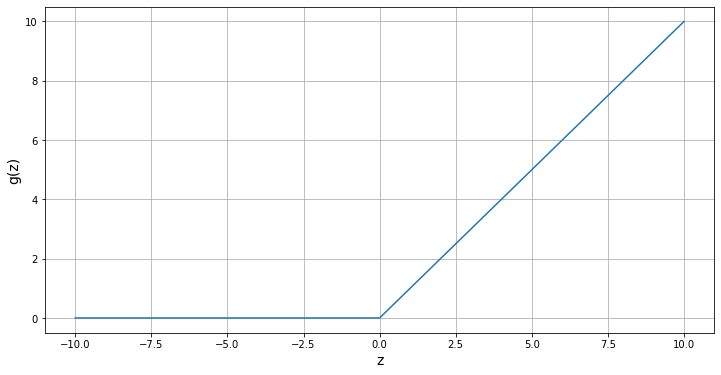

In [3]:
%run ../scripts/visualize/relu_sample.py

Kodėl `relu` veikia o `identity` ne ? Jeigu net turime paslėptą sluoksnį ir tiesinę aktivacijos funkcija tai kas atsitinka yra tiesiog kombinacija tarp daugybės tiesinių funkcijų/modelių ir ši kombinacija yra vistiek tiesinė funkcija, tai daryti mes nieko negauname su paslėptu sluoksniu. 

Yra gerokai daugiau nei tik `relu` funkcija. Relu yra tiesiog labai populiari nes tai ir paprasta ir lengvai skaičiuojama funkcija. Tai pat turi ir kitų savybių kurios mums bus dar naudingos. 

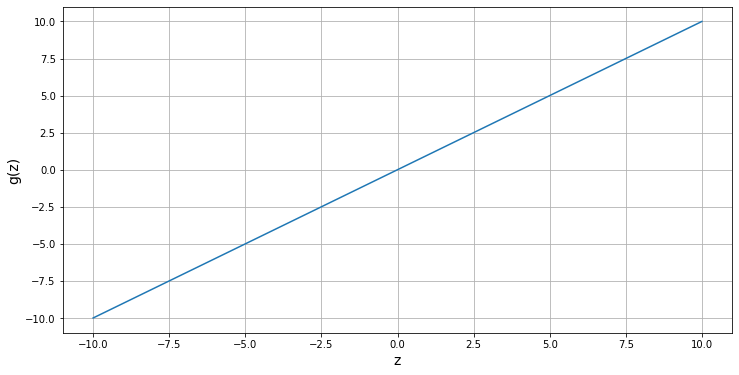

In [5]:
%run ../scripts/visualize/identity.py

\begin{multline*}
\sigma(z) = z
\end{multline*}

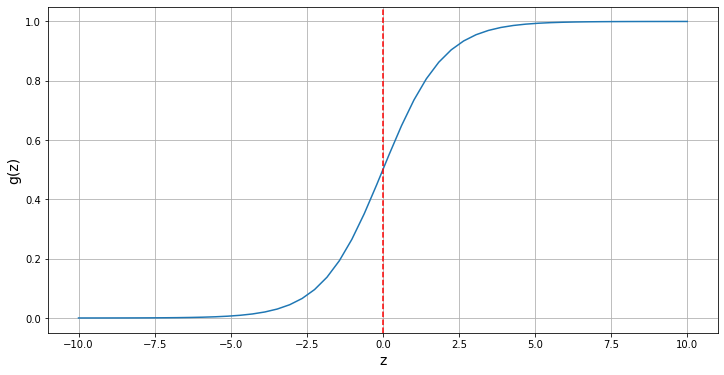

In [10]:
%run ../scripts/visualize/sigmoid_function.py

\begin{multline*}
\sigma(z) = \dfrac{1}{1 + e^{-z}}
\end{multline*}

Anskčiau su MLP taikymu buvo naudojamos sigmoidinės aktivacijos funkcijos bet su ja mes turime gradientų saturacijos problemą.

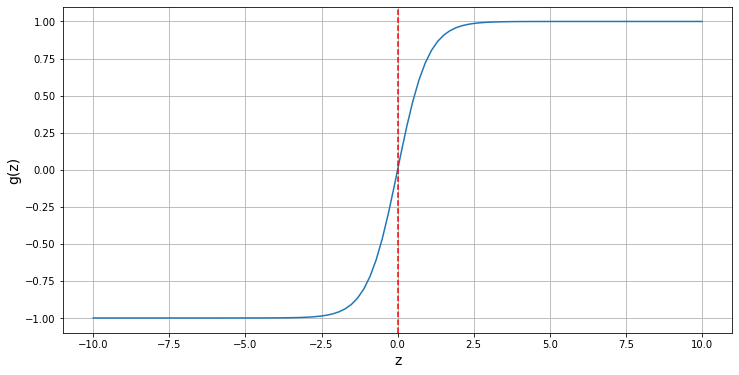

In [16]:
%run ../scripts/visualize/tanh.py

\begin{multline*}
\sigma(z) = \dfrac{e^{z} - e^{-z}}{e^{z} + e^{-z}}
\end{multline*}

Ši funkcija irgi buvo labia populairi , ji tai pat yra asimptotė. Bet ši hiperbolinė tangento funkcija truputi kitokė nei sigmoidinė funkcija, centras koordinatės yra (0,0). Ši aktivacijos funkcija kitaip nei sigmoidinė gali turėti ir neigiamas ir teigiamas reiškmės. Taip pat yra statesnė todėl turime didesnius gradientus nei sigmoidinė funkcija, ir turi šiek tiek paprastesnę išvestinę.

\begin{multline*}
\dfrac{d}{dz}g(z) = 1 - g(z)^{2}
\end{multline*}

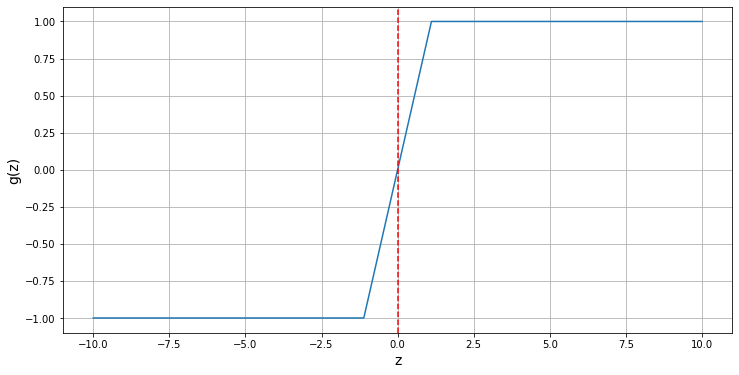

In [20]:
%run ../scripts/visualize/htanh.py

\begin{multline*}
\sigma(z) = \left\{ \begin{array}{ll}
         \ \ \ 1 & \mbox{if $z > \ \ \ 1$}\\
         -1 & \mbox{if $z < -1$}\\
         \ \ \ z & \mbox{otherwise}\end{array} \right.
\end{multline*}

Labai panaši į hiperbolinę tangento funkcija tik turi slenksčius.

Pašios papuliariausios yra `ReLU (Rectified Linear Unit`, `Leaky ReLU`, `ELU (Exponential Linear Unit)`, `PReLU (Parametrized Rectified Linear Unit)`
dėl to kad lengva skaičiuoti ir dideles išvestines , ~ 1 tarkime naudojat grandines taisykles kai įvestis yra pozityvios reikšmės produktas nesumažės šioje taisyklėje. Tačiau gali būti ir 0, tarkime jeigu turime neigiamas įvesties reikšmes tai galima sakyti atšauks svorių ataujinimą susieitą su šia aktivacija. Šis reiškinys vadinamas <code>**mirštantis neuronai (dying neurons)**</code> arba <code>**miręs ReLU**</code>. Bet tai gali ir būti privalumas jeigu turime perteklinį skaičių neuronų, tai veiks kaip nereikalingų neuronų šalininmas.
 
 - ReLU yra populiariausia aktivacijos funkcija nes yra greita, lengvai skaičiuojasi ir duoda gerus rezultus
 - Bet turėti galvoje kad neuronai gali "mirti" atliekant NN treniravimą. Tai gali atsitikti kai bendrinė įvestis yra labai maža (gradientas 0 kai z < 0)
 - Bet tai nebūtinai yra blogai nes tai gali veikti kaip reguliarizacijos forma

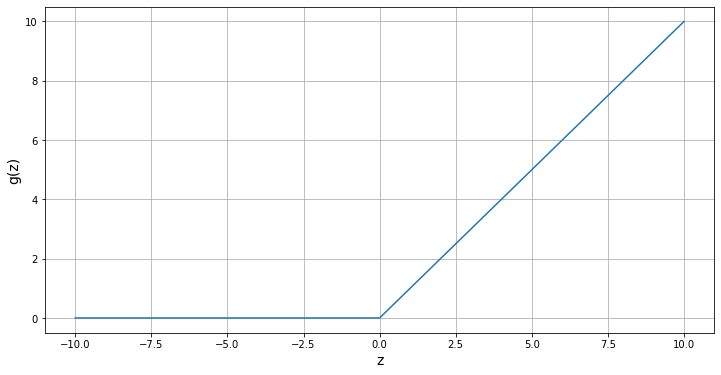

In [22]:
%run ../scripts/visualize/relu_sample.py

\begin{multline*}
\sigma(z) = \left\{ \begin{array}{ll}
         z & \mbox{if $z \geq 0$}\\
         0 & \mbox{otherwise}\end{array} \right.
\end{multline*}

Leaky ReLu neturi "mirštančių neuronų" problemos bet reikia rasti gerą alfa parametrą kuris kontroliuoja neigiamą nuolydį. Geri kandidatai yra tarp 0.1 - 0.01

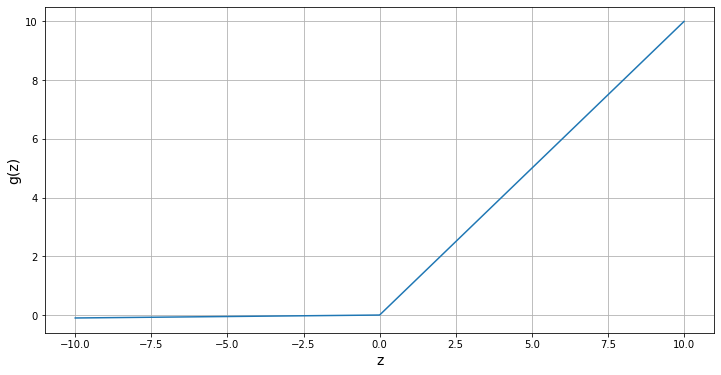

In [24]:
%run ../scripts/visualize/relu_leaky.py

\begin{multline*}
\sigma(z) = \left\{ \begin{array}{ll}
         z & \mbox{if $z \geq 0$}\\
         a \times z & \mbox{otherwise}\end{array} \right.
\end{multline*}

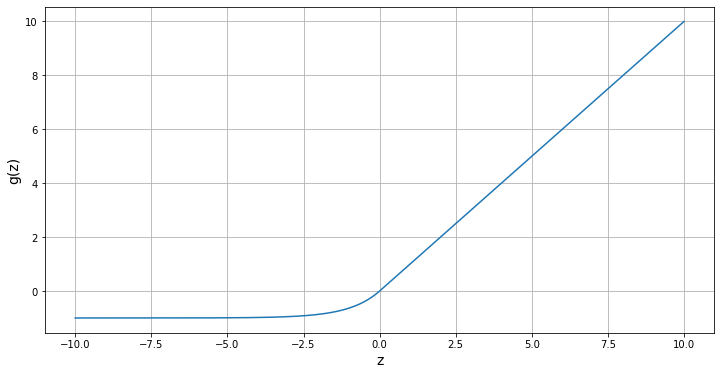

In [28]:
%run ../scripts/visualize/elu.py

\begin{multline*}
g(z) = \left \{ \begin{array}{rcl} \alpha \times (e^{z} \ \ – 1 ) & \mbox{for} & z \le 0\\ z & \mbox{for} & z > 0\end{array} \right.
\end{multline*}

## Plotis vs Gylis architektūros

MLP su vienu dideliu paslėptu sluoksniu yra universalus funkcijų aproksimatoriai tai kam mums reikalinga naudoti gylią architektūrą ? Kuris geresnis ?

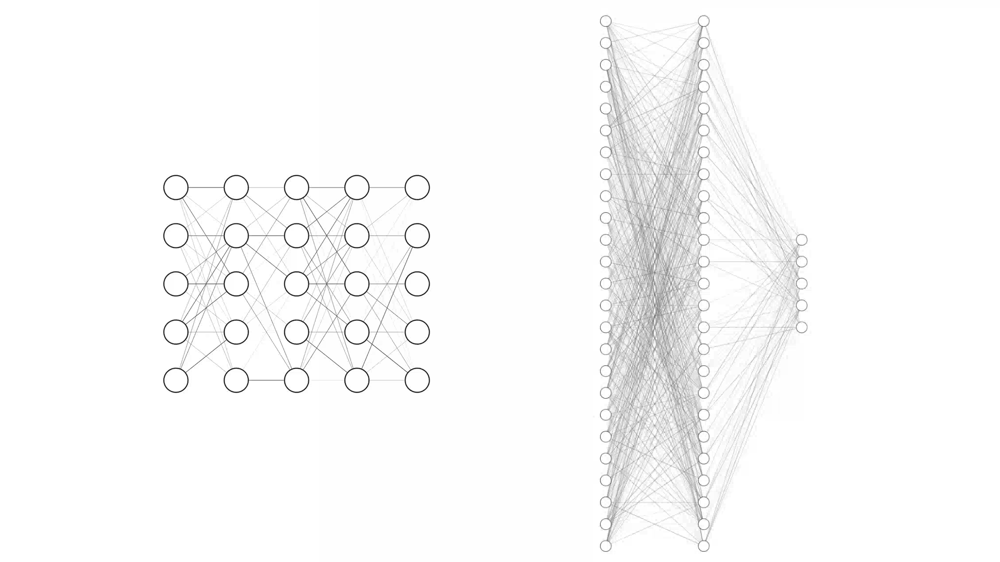

Teoriškai buvo nemažai darbų dėl `universal approximator theorem`, kurios rodo kad MLP su dideliu paslėptu sluoksniu gali approksimuoti įvairias funkcijas. Bet ši savybė nedaro tokio NN treniravimą praktišku, pirma bėda kyla iš dideliu matricų operacijų, antra kad reikės daugiau parametru kad turėtume tokį pati NN ekspresyvumą kokį turime su gyliais neuroninias tinklais ir kuriems reikia kur kas mažiau parametrų. Jeigu turime mažiau parametrų bet daugiau sluoksnių tai kombinatoriškai gauname tą pati ekspresyvumą/lansktumą kaip ir su MLP kuris turi didelius kelis paslėptus sluoksnius tik papildomai didesnę tikimybę išvengti perdėto prisiderinimo prie duomenų pavyzdžių (ang. overfitting) . Praktikoje su MLP nedarome gylesnis nei vienas ar du paslėpti sluoksniai nes antraip atsiranda taip vadinama <code>**nykstančių/sprogstančių gradientų problema**</code> kuria plačiau aptarsime sekančiose paskaitose. Vėliau kalbėsime apie kitokios architektūros NN kuriems nebūdinga šį problema.

## Neuroniniu tinklų apmokymas

Tai yra skirtingai generiniai būdai ir <code>**rėžimai: online, batch, minibatch**</code> kuriais mes galime apmokyti bet kokio tipo neuroninį tinklą. Šie rėžimai skirtingai panaudoja mūsų duomenis, kai mokome neuroninio tinklo modelį. Principe šie rėžimai reguliuoja kaip ir kokia tvarka duomenys yra skaitomi atsižvelgiant į mokymo epochas ir tai pat kaip vyksta modelio svorių atnaujinimas.

### Online

Perceptrono atveju mes turėjome duomenų rinkinį 𝐃, su etikėtimis {0,1}. Kai perceptronas treniravomsi šu šiais duomenimis , pirma mes inicializavome perceptrono parametrus. Tarkime galime nustatyti visus svorius ir poslinkį lygius 0. Ir kiekvienai epcohai kurių gali būti daug t.y kiekvienam ciklui per duomenų rinkinį. Praktikoje šis epochų skaičius priklauso ir nuo duomenų rinkinio ir kokio sudėtingumo problema yra sprendžiama. Prasidėjus epochos pirmam ciklui mes pradedame kitą ciklą, ėjimą po vieną per kiekvieną duomenų įrašą. Taigi turime du ciklus.

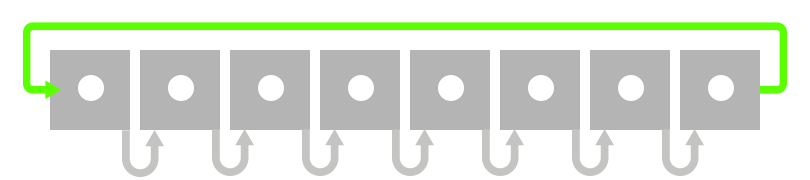

 - <code>**1.**</code> Inicijuojame w:= 0, ∈ ℝ^𝑚, b:= 0
 - <code>**2.**</code> Kiekvienai epochai/iteracijai:
   - <code>**A.**</code> Kiekvienam duomenų įrašui iš duomenų rinkinio 𝐃 \begin{multline*}\langle x^{[i]}, y^{[i]}\rangle \in \mathbf{D} :\end{multline*}
     - \begin{multline*} \hat{y} := \sigma(\mathbf{x^{[i]}}^{\top} \mathbf{w}) \end{multline*}
     - \begin{multline*} \text{err} := (y^{[i]} - \hat{y}^{[i]}) \end{multline*}
     - \begin{multline*} \mathbf{w} := \mathbf{w}  + \text{err} \times \mathbf{x}^{[i]} \end{multline*}

Kiekviena duomenų įrašui (taškui) skaičiuojama:
 - Išvestis (prognozė)
 - Klaida
 - Skaičiuojamas ir atliekamas parametrų (w ir b vektorius) atnaujinimas.
 
<code>**Pastaba:**</code> atkreipkite dėmesi kad atnaujinimas vyksta imtinai kiekvienam duomenų įrašui (taškui). Ši koncepcija vadinama <code>**online**</code> metodu ir gali būti taikomas neuroniams tinklams, tiesinei ir logistinei regresijai. Ir ši koncepcija turi kelis variantus, vienas vadinamas "paketinis režimas" (ang. batch mode) ir kitas "mini paketo rėžimas" (ang. minbatch mode). Iš esmės abu yra online rėžimo modifikacijos ir turi keletą privalumų kuriuos netrukus aptarsime.<br>

Online mokymosi rėžimas dar kartais vadinamas `stochastiniu` rėžimu, ir tai susiję su `stochastiniu gradientiniu nusileidimu`. Yra dar vienas mokymosi atlernatyvus online rėžimas. Užuot naudojęs visą duomenų rinkinį algoritmas šiame metode per ribotą iteracijų skaičų atsitiktinai ims įrašus iš duomenų rinkinio ir taip gali nutikti kad vienas ir tas pats taškas bus panaudotas keletą kartų o kai kurie niekada. Tai vadinamas `tikrasis stochastinis rėžimas`.

### Batch

Skirtumas yra kad pirma yra surenkama informacija kaip atnaujinsime modelio parametrus prieš juos atnaujinant. Naudojame tą patį kiekį taškų šiame rėžime bet užuot atnaujine parametrus po kiekvieno taško mes renkame informacija o tik po to atliekamas atnaujinimas tik po kiekvienos epochos. 

 - <code>**1.**</code> Inicijuojame w:= 0, ∈ ℝ^𝑚, b:= 0
 - <code>**2.**</code> Kiekvienai epochai/iteracijai:
   - <code>**A.**</code> Inicijuojame Δ𝐰:= 0, Δ𝐛:= 0
   - <code>**B.**</code> Kiekvienam duomenų įrašui iš duomenų rinkinio 𝐃 \begin{multline*}\langle x^{[i]}, y^{[i]}\rangle \in \mathbf{D} :\end{multline*}
     - \begin{multline*} \hat{y} := \sigma(\mathbf{x^{[i]}}^{\top} \mathbf{w}) \end{multline*}
     - \begin{multline*} \text{err} := (y^{[i]} - \hat{y}^{[i]}) \end{multline*}
     - \begin{multline*} \Delta \mathbf{w} := \Delta \mathbf{w},\Delta \mathbf{b} := \Delta \mathbf{b}  \end{multline*}
   - <code>**C.**</code>
     - \begin{multline*} \mathbf{w} :=\mathbf{w} + \Delta \mathbf{W}, \mathbf{b}:= \mathbf{b} + \Delta \mathbf{b}\end{multline*}

Pirmas skirtumas kad prasidėjus 1 epochai mes inizializuojame Δ𝐰, Δ𝐛 kurie bus informacijos dėl pokyčio kuri taikysime atnaujinti 𝐰,𝐛 laikykliai/agregatoriai. Tada atliekama iteracija per visus duomenų įrašus taškus ir skaičiuojama:
 - Išvestis (prognozė)
 - Klaida
 - Atnaujiname/agreguojame klaidos terminus kurie išreikšti pokyčio dydžiais.
 
Ir kai baigiasi iteracijų per duomenų taškus ciklas atnaujiname abu parametrus pasinaudodami agreguotomis pokyčio reikšmėmis.<br>

Pirmas skirtumas tarp online ir batch rėžimu, tai kad pirmasis atlieka atnaujinimą su kiekvienu tašku ir tai gali būti triukšmingas procesas dėl daugybės atnaujinimu, kai tuo tarpu batch rėžimas pirma renka statistinę informaciją iš viso duomenų rinkinio prieš atliekant atnaujinimą. Batch mode yra lėtesnis procesas nes atliekamas atnaujinimas tik partą per epochą bet atnaujinimas bus tikslesnis. 

<div class="alert alert-block alert-info">

<h4>Shuffle</h4>
Praktikoje mes sumaišome duomenų rinkinio įrašus (taškus) prie pradėdami epochos ciklus kaip cikliškumo prevencija. Tai reiškia kad kartais taip gali nutikti kad algoritmas gali užstrigti judėdamas pirmyn ir atgal todėl empiriškai yra daug geriau sumaišyti duomenys prieš pradedant epochu ciklus. Isivaizduokite tarkimie vilkdagių duomenų rinkinį. Ji užkrovus etiketės yra išrikuotos pagal 
kategorijas , - 0, 1, 2. Tai pirmieji 33% irašų bus su etikete 0, tada kitas intervalas nuo 33% iki 66% irašai su etikete 1 ir t.t. Alogirtmas dirbdamas online rėžimu turės problemą kad atliks atnaujinmus tik su įrašais kuriu etitkete 0 ir galbut tai bus lengva užduotis. Ir tuomet vėliau susidurs su nauja klase kuria mėgins išmokti ir omptizuotis bėt praras gebėjimą identifikuoti prieš tai buvusią kategoriją. Todėl reikia duomenų rinkinį sumaišyti kad turėtume įvairovę.
</div>

### Minibatch

Tai yra online ir batch rėžimu mikstūra. Panašiai kaip anuose rėžimuose mes inizializuojame parametrus kuriuos norėsime atnaujinti, iteruojame per epochas, ir tai pat iteruojame per mini paketus. Mini paketai yra <code>**subaibės iš duomenų rinkinio, tiesiog isviaizduokite kad savo duomenų rinkinį padalinote į kelis lygius paketus, mb1, mb2, mb3 ir t.t**</code> Tipinis mini paketo dydis kuri naudoja yra `32, 64, 128, 256, 512, ir t.t`. Tai priklauso nuo problemos kurią sprendžiame tai tarytum hypeparametras kuris reikia išbandyti ir stebėti kas veikia. Yra publikacijų kurios tvirtina kad mažesni mini paketai gali akseleruoti mokymasi nes tai triukšmingiau ir triukšmas padeda atlikti atnaujinimus greičiau. Tuo tarpu didesni paketai labiau išnaudoja GPU. Bet daugiau apie tai aptarsime kai kalbėsime apie temą `paketo normalizavimas`. 

 - <code>**1.**</code> Inicijuojame w:= 0, ∈ ℝ^𝑚, b:= 0
 - <code>**2.**</code> Kiekvienai epochai/iteracijai:
   - <code>**3.**</code> Kiekvienam mini paketui kurio dydis 𝑘: 
       - <code>**A.**</code> Inicijuojame Δ𝐰:= 0, Δ𝐛:= 0
       - <code>**B.**</code> Kiekvienam duomenų įrašui iš duomenų rinkinio 𝐃 \begin{multline*}\{\langle x^{[i]}, y^{[i]}\rangle , ..., \langle x^{[i+k]}, y^{[i+l]}\rangle\} \in \mathbf{D} :\end{multline*}
         - \begin{multline*} \hat{y} := \sigma(\mathbf{x^{[i]}}^{\top} \mathbf{w}) \end{multline*}
         - \begin{multline*} \text{err} := (y^{[i]} - \hat{y}^{[i]}) \end{multline*}
         - \begin{multline*} \Delta \mathbf{w} := \Delta \mathbf{w},\Delta \mathbf{b} := \Delta \mathbf{b}  \end{multline*}
       - <code>**C.**</code>
         - \begin{multline*} \mathbf{w} :=\mathbf{w} + \Delta \mathbf{W}, \mathbf{b}:= \mathbf{b} + \Delta \mathbf{b}\end{multline*}

Šis rėžimas labai panašus į paketo rėžimą ir tai yra dažniausiai naudojamas rėžimas. Nes:
1. Dirbant su subaibėmis galima lengviau išaudoti vektorizaciją nei dirbant su pavieniais taškais;
2. Atliekant parametrų atnaujinimą rečiau nei online rėžime atnaujinmai yra mažiau triukšmingi;
3. Atlieka daugiau atnaujinimu per epocha nei vien tik paketo rėžimas todėl yra greitesnis.

## Perteklinis ir nepakankamas pritaikymas

Dydžioji neuroninių tinklų ir kitų modelių problema yra ta kad fėl dvejų priežasčių negalime gauti gerų rezultatų. Tos priežastis, pavyzdžiui jeigu taikysime paprastą logistinę regresiją su MNIST duomenų rinkiniu tikėtina mūsų modelis bus per paprastas kad gebėtu pristaikyti prie tokių duomenų, o jeigu neudosime MLP ir su per daug savybių tuomet prisitaikymas bus perteklinis. 

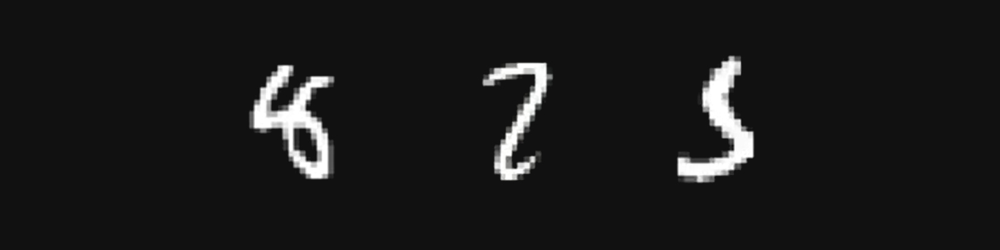

In [1]:
#TODO MNIST samples

In [ ]:
#TODO generizalion and training error

Perteklinis prisitaikymas (ang. overfitting) yra tai kad modelis įsimena savybes kurios yra labai specifiškos bet tik treniravimo duomenų rinkinį, tačiau negali generalizuoti testiniame rinkinyje.
Viršuje turi grafika kuris demonstruoti šį procesą. Horizontalioje ašyje yra modelio pajėgumas (parametrų arba sluoksnių skaičius representuonačių modelio kompleksiškumą ir gebėjimą prisitaikyti prie kompleksinių duomenų) ir vertikalioje ašyje klaidos dydis. Stebint treniravimo fazės klaidą akivaizdu kad su modelio komplesiškumu mažėja ir klaida. Tačiau testavimo atveju ką mes tipiškai matome kad pasiekus tam tikrą kompleksiškumo lygmenį klaidos lygmuo pradeda augti. Modelis turi tiek daug parametrų kad pradeda isiminti tam tikras savybes, braižus treniravimo fazejė kurie nesigeneralizuoja su testavimo duomenimis. Tarkim vaizdo atveju tai gali būti individualių pikselių pozicijos sureikšminimas labiau nei generinių formų. 
Kitas kraštutinis atvejis grafike yra kada modelis nėra pakankamai komplesiškas kad pajėgtų fiksuoti duomenų savybių ypatybes todėl klaidos lygmuo tai pat yra aukštas. 
Perteklinis prisitaikymas dažniausiai registruojamas atsižvelgiant į tarpą tarp treniravimo ir testavimo fazių rezultatų parodymų. Taip yra nustatomas perteklinio prisitaikymo lygmuo. 

#### Šališkumo - Variacijos dekonstrukcija

Kartais sutiksite literatūroje, straipsnuose pasakymus kad modelis turi aukšta variacija (ang. variance)arba aukšta šališukumą (ang. bias). Tai susiję su modelio pertekliniu arba per menku pristaikymu prie duomenų (ang. overfitting, underfitting). 

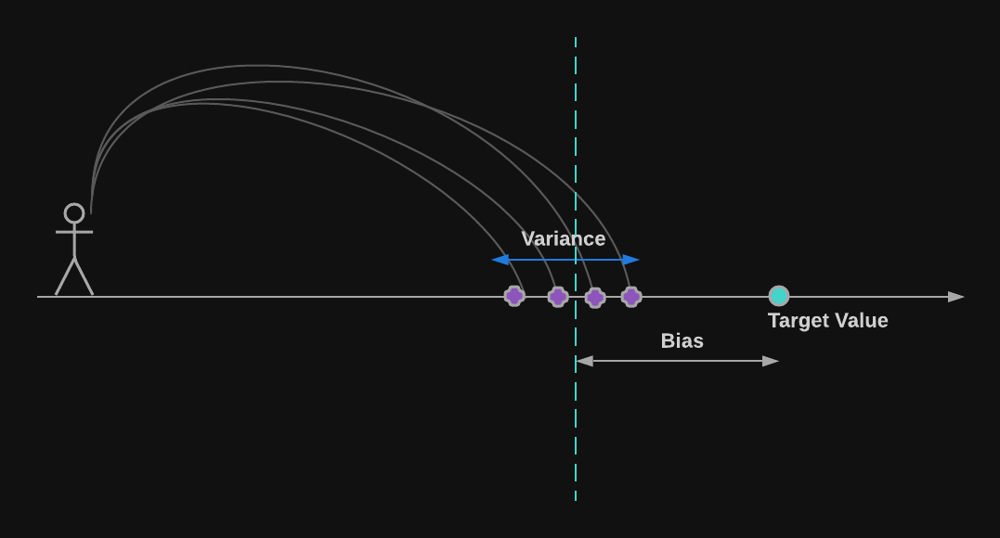

Isivaizduokite kad turime kokį nors regresijos modelį. Ir tarkime 𝜃 yra reikšmė kurią norime prognozuoti. Tai 𝜃 yra tikroji reikšmė, o modelis sukuria 𝜃 (hat) prognozę. 

\begin{multline*}
\text{bias}_{\ \theta} = E[\hat{\theta}] \ - \ \theta
\end{multline*}

Galvokime apie šališkumo ir variacjos vertinimą kvadarinės klaidos kontekste. Tarkime turime daug treniravimo duomenų rinkininių. Papratai tai turime vieną bet čia dėl iliustracijos tikslų galvokime kad turime daug. Tarkime 1 tks. tokių rinkinių ir kiekvieą kartą kai treniruojame regresijos modelį ant vieno iš rinkinio gauname truputi skirtingą modelį, nes duomenų rinkiniai nėra identiški. Ir dabar turime 1 tks. modelių kurie darys to vieno taško prognozę.


\begin{multline*}
\text{bias}_{\ \theta} = E[\hat{\theta}^{[i]}] \ - \ \theta^{[i]}
\end{multline*}

Ir po šių prognozių mes išvedame vidrukį to taško prognozei. Ir skirtumas tarp tos prognozės ir tikrosios reikšmės bus mūsų <code>**šališkumas (ang. bias)**</code> tarytumei įvertinimas kaip vidutiniškai esame toli nuo tikrosios reikšmės.

Variacijos definicija šiek tiek kitokia, ji nusako kaip išplitusios yra šios prognozės. Viršuje esanti illiustracija gana gerai paiškina šį reiškinį.

\begin{multline*}
\text{var}_{\ \theta} = E[\hat{\theta^{2}}] \ - \ (E[\hat{\theta})^{2}
\end{multline*}

\begin{multline*}
\text{var}_{\ \theta} = E[(E[\theta^{2}] - \hat{\theta})^{2}]
\end{multline*}

Modelis su didele variacija tikėtina labiau turės perteklinį prisitaikymą, o modelis su dideliu šališkumu turės didelę klaidą nuo tuo savo tikslo todėl laikomas su nepakankamu prisitaikymu ir nepakankamai komplesiškas.

In [3]:
#TODO: grafikas su model capacity, bias, variance, error kreivėmis

Gylusis mokymasis geriausiai dirba su dideliais duomenų rinkiniais. Jeigu palyginti tradicinius ML modelius tarkime (ang. decision trees, random forest, support vector machines) su DL modeliais pastebėsite kad nuo didesnio duomenų kiekio DL modelių efektyvumas išauga.

[Deep double descent: Where bigger models and more data hurt](https://arxiv.org/pdf/1912.02292.pdf)

In [4]:
#TODO: grafilas su ML ir DL generalization erorr vs training dataset size

## Pytorch duomenų krautuvai

Konceptuali diagram kaip dirba pytorch duomenų krautuvas. Kairėje pusėje yra duomenų įvestis t.y savybės (x) kartu su etiketėmis (y). Tuomet atliekama konkreti transformacija, aptarsime šią operaciją kai nagrinėsime kodą. Toliau seka mėginių ėmiklis (ang. sampler) šis procesas ima mėginius po vieną porą vienu metu, kuris yra integruotas į pakuotės mėginių ėmiklį, o pastarasis ima mėginus pakuotei. Gretinimo ir suktikrinimo funkcija (collate) kombinuoja mėginius mini pakuotei kurią naudosime treniruoti modelį. Mėginiai yra imami atsitiktinai be pasikartojačių pavyzdžių, kiekvienas pavyzdys poroje (x, y) yra panaudojamas tik kartą. 

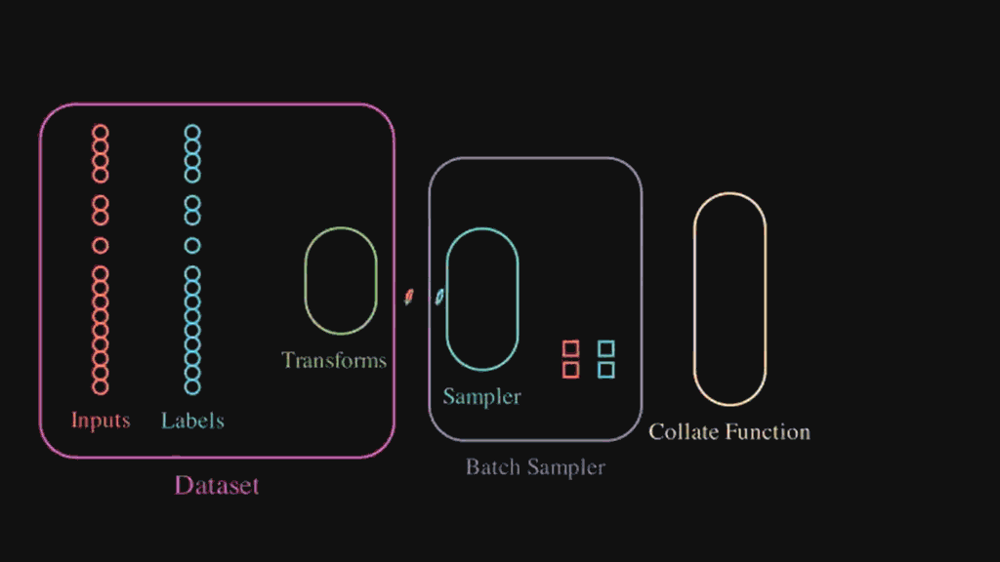

`DataLoader` PyTorch bibliotekoje yra klasė kuri leidžia mums užkrauti duomenys daug patogiau palyginus nei kad su manualiu būdu. Naudosime stripriai redukuota MNIST ranką rašytu skaičiu duomenų rinkinį. Principe panašu į tą kuri naudojome  <code>**__III_nn_impl_pytorch.ipynb**</code> žurnalo atroje dalyje. Tačiau ten MNIST buvo integruotas į PyTorch duomenų rinkinius, o šiuo atveju mes kursime savo duomenų rinkinį, tik daug mažesni. 

- Duomenų krautuvo pavyzdys: [__I_dataloader_expl.ipynb](./code/dataloader/__I_dataloader_expl.ipynb)
- Krautuvo taikymas: [__II_train_model.ipynb](./code/dataloader/__II_train_model.ipynb)

### Sidetrack

<div class="alert alert-block alert-info">
<h4>TODO: coverage</h4>
    
- error functions
- softmax (not covered)
- one-hot kodavimas
- maximum likelihood
- maximizing probabilities
- kryžminė entropija (not covered)
- daugiaklasė kryžminė entropija (not covered)
- gradientinis nusileidimas ✓
- online, batch, minibatch  ✓ 
- ryšys tarp perceptrono ir tiesinės regresijos ✓
- iteratyvus tiesinės regresijos algoritmas
- adaline / kodas ?
- PyTorch auto diferenciacija ir skaičiavimo grafikai / kodas
- PyTorch API apžvalga
- logistinė regresija kaip vieno sluoksnio neuroninis tinklas
- logistinės regresijos kainos/klaidos funkcija
- logistinės regresijos kainos/klaidos funkcija išvestinės
- logitai ir kryžminė entropija
- logistinė regresija kodas
- daugiamatė logistinė regresija ir softmax
- onehot koduotė ir daugiamatės logistinės regresijos daugiaklasė kryžminė entropija / kodas
- softmax regresijos išvestinės gradientinio nuolydžio algoritmui  / kodas
    
</div>